<h1>Importing Required Libraries</h1>

In [1]:
import numpy as np
import numpy.linalg as LA
import matplotlib.pyplot as plt
import math
import cv2

<h2>Reading the required images through cv2.imread()</h2>

In [2]:
input_image=input_image=cv2.imread("./calibration-data/calib-object.jpg",cv2.COLOR_BGR2RGB)
input_image_calib=cv2.imread("./calibration-data/calib-object-legend.jpg",cv2.COLOR_BGR2RGB)

<h3>Used Plotly to find required image co-ordinates by hovering</h3>
<h4>can be installed using "pip install dash"


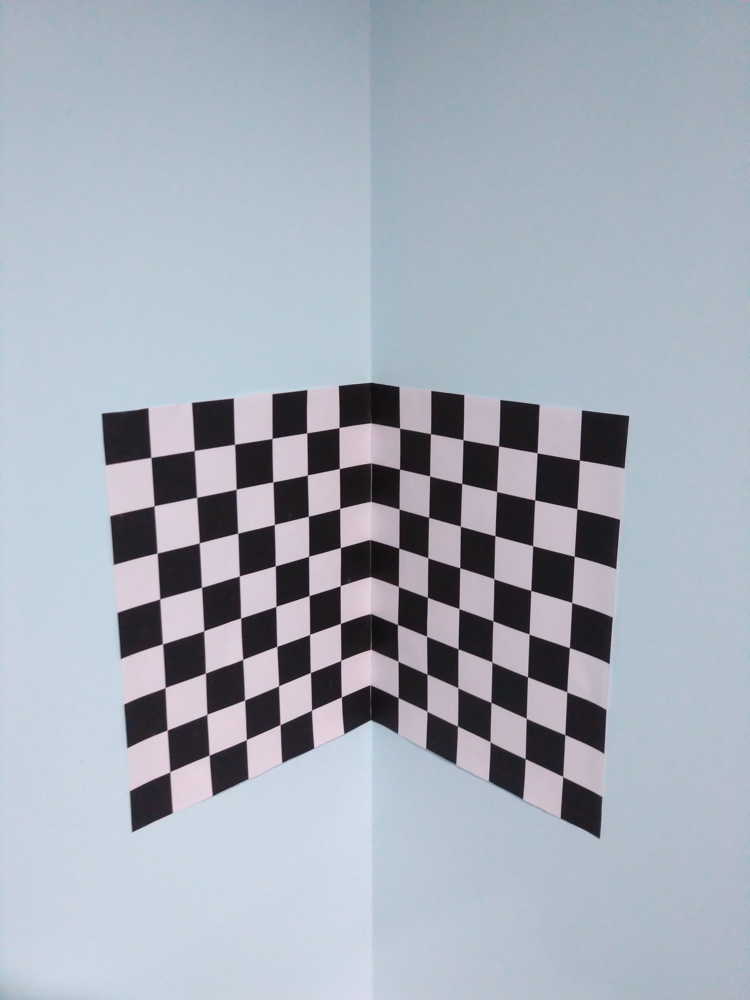

In [3]:
#Code for estimating image co-ordinates
import plotly.express as px
input_image=cv2.imread("./calibration-data/calib-object.jpg")
fig = px.imshow(input_image)
fig.show()

<h3>Calculated world co-ordinates by assuming origin and axis as shown in calib-object-legend.jpg</h3>

In [4]:
#scale can be chaged to 100 in order for 2800mm*2800mm
scale=1
world_co=scale*np.array([[28,28,0],[0,28,28],
                   [0,56,28],[28,56,0],
                   [56,28,0],[84,28,0],
                   [0,84,56],[0,112,56],
                   [112,28,0],[112,56,0],
                   [140,84,0],[0,28,168],
                   [0,28,140],[0,56,168],
                   [0,56,140],[84,140,0],
                   [84,168,0],[112,140,0],
                   [112,168,0],[0,112,28]])
print(world_co.shape)

(20, 3)


<h3>Image co-ordinates of corresponding world co-ordinates</h3>

In [5]:
image_co=np.array([[1664,1782],[1413,1780],
         [1412,1950],[1662,1953],
         [1790,1806],[1929,1830],
         [1282,2150],[1286,2317],
         [2076,1857],[2067,2046],
         [2217,2271],[629,1904],
         [810,1877],[643,2105],
         [819,2069],[1909,2532],
         [1907,2700],[2051,2584],
         [2047,2750],[1416,2280]])
print(image_co.shape)

(20, 2)


<h3>Displaying points used for calibration</h3>

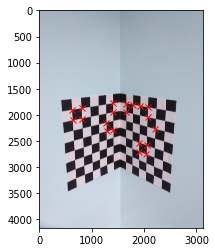

In [6]:
plt.imshow(input_image)
for point in image_co:
    plt.plot(point[0],point[1],'rx')
plt.show()

<h3>MSE_error&#8594;outputs mean squared error b/w projected points and actual points</h3>
<h4>inputs&#8594;p(projection matrix),world_co(co-ordinates of world points),image_co(corresponding image co-ordinates)</h4>
<hr>
<h3>DLT&#8594;outputs the 3*4 projection matrix</h3>
<h4>inputs&#8594;world_co(co-ordinates of world points),image_co(corresponding image co-ordinates)</h4>

In [7]:
def MSE_error(p,world_co,image_co):
    num_points=world_co.shape[0]
    hom_world_co=np.concatenate((world_co,np.ones((num_points,1))),axis=1)
    proj_img_co=p@(hom_world_co.T)
    proj_img_co= (proj_img_co/ proj_img_co[2,:])[:2]
    error = np.mean(LA.norm(proj_img_co-image_co.T,axis=0))
    return error
    
def DLT(world_co,image_co):
    num_points=world_co.shape[0] if world_co.shape[0]==image_co.shape[0]else -1
#     print(world_co.shape,image_co.shape)
    if(num_points==-1):
        return np.array([])
    input_matrix=np.zeros((num_points*2,12))
    for i in range(num_points):
        x_world=world_co[i][0]
        y_world=world_co[i][1]
        z_world=world_co[i][2]
        x_image=image_co[i][0]
        y_image=image_co[i][1]
#         print(type(x_world),x_world.shape)
#         if(i==num_points-1):
    #         print(x_world,y_world,z_world,x_image,y_image)
        input_matrix[i*2]=np.array([-x_world,-y_world,-z_world,-1,0,0,0,0,x_world*x_image,y_world*x_image,
                             z_world*x_image,x_image])
#         if(i==num_points-1):
#             print(input_matrix[i])
        input_matrix[i*2+1]=np.array([0,0,0,0,-x_world,-y_world,-z_world,-1,x_world*y_image,y_world*y_image,
                             z_world*y_image,y_image])
#     print(input_matrix[2])
    U,D,V=np.linalg.svd(input_matrix)
    return V[-1,:].reshape(3,4)

<h3>Decompose&#8594; K(intrinsic matrix),R(rotation matrix),t(translation vector)</h3>
<h4>Inputs&#8594;3*4 projection matrix</h4>

In [8]:
def decompose(p):
    M = p[:,:3]
    p4 = p[:,3]
    M_inv=LA.inv(M)
    t=-M_inv@p4
    Q,R=LA.qr(M_inv)
    R=LA.inv(R)
    return R/R[2,2],Q.T,t

<h3>Applying DLT,decompose,MSE_error and printing the results</h3>

In [9]:
P=DLT(world_co,image_co)
print("Projection Matrix")
print(P)
K,R,t=decompose(P)
print("Internal camera matrix")
print(K)
print("Rotation matrix")
print(R)
print("Translation vector")
print(t)
print("Reconstruction error")
print(MSE_error(P,world_co,image_co))

Projection Matrix
[[ 1.13300367e-03  2.73561120e-04 -2.78149675e-03  6.95919308e-01]
 [-5.35710801e-04  3.04354718e-03 -5.33282999e-04  7.18106665e-01]
 [-5.04266654e-07  1.76784395e-07 -4.87237693e-07  4.51611489e-04]]
Internal camera matrix
[[3.85481450e+03 4.57484873e+00 1.59153702e+03]
 [0.00000000e+00 3.82558619e+03 2.04236068e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Rotation matrix
[[-0.69413826  0.00394809  0.71983088]
 [-0.17863443 -0.96964979 -0.16694022]
 [ 0.69732476 -0.24446617  0.67377628]]
Translation vector
[454.30112472 -81.11456506 427.27152511]
Reconstruction error
1.4232967246849282


<h3>Combining the decomposed matrices and verifying with original P matrix</h3>

In [10]:
#Verification wether the obtained decomposition is right(It can be seen it is correct)
temp=(K@R)[0][0]
print(K@R)
print(-K@R@t)
print(P*temp/P[0][0])

[[-1.56677326e+03 -3.78293789e+02  3.84639068e+03]
 [ 7.40807278e+02 -4.20876692e+03  7.37449993e+02]
 [ 6.97324762e-01 -2.44466167e-01  6.73776276e-01]]
[-9.62351490e+05 -9.93033261e+05 -6.24510607e+02]
[[-1.56677326e+03 -3.78293789e+02  3.84639068e+03 -9.62351490e+05]
 [ 7.40807278e+02 -4.20876692e+03  7.37449993e+02 -9.93033261e+05]
 [ 6.97324762e-01 -2.44466167e-01  6.73776276e-01 -6.24510607e+02]]


<h3>r_pie is the R<sub>z</sub>($\pi$) rotation matrix</h3>
<h3>Modifying K and R if camera parameters are positive and printing old and new values</h3>

In [11]:
r_pie= np.array([[-1,0,0],[0,-1,0],[0,0,1]])
if(K[0][0]>0):
    print(K)
    print(R)
    print(K*R)
    new_K=K@r_pie
    new_R=R@r_pie
    print(new_K)
    print(new_R)
    print(new_K*new_R)

[[3.85481450e+03 4.57484873e+00 1.59153702e+03]
 [0.00000000e+00 3.82558619e+03 2.04236068e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
[[-0.69413826  0.00394809  0.71983088]
 [-0.17863443 -0.96964979 -0.16694022]
 [ 0.69732476 -0.24446617  0.67377628]]
[[-2.67577422e+03  1.80619309e-02  1.14563750e+03]
 [-0.00000000e+00 -3.70947883e+03 -3.40952133e+02]
 [ 0.00000000e+00 -0.00000000e+00  6.73776276e-01]]
[[-3.85481450e+03 -4.57484873e+00  1.59153702e+03]
 [ 0.00000000e+00 -3.82558619e+03  2.04236068e+03]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[[ 0.69413826 -0.00394809  0.71983088]
 [ 0.17863443  0.96964979 -0.16694022]
 [-0.69732476  0.24446617  0.67377628]]
[[-2.67577422e+03  1.80619309e-02  1.14563750e+03]
 [ 0.00000000e+00 -3.70947883e+03 -3.40952133e+02]
 [-0.00000000e+00  0.00000000e+00  6.73776276e-01]]


<h3>normalise_3d&#8594;returns normalised world co-ordinates,matrix used for normlisation(U,for later use)</h3>
<h3>normalise_3d&#8594;returns normalised image co-ordinates,matrix used for normlisation(T,for later use)</h3>
<p>We construct the normalisation matrices as mentioned in slides given and multiply them with the input co-ordinates</p>

In [12]:
def normalise_3d(co):
    x=co[:,0]
    x_mean=np.mean(x)
    y=co[:,1]
    y_mean=np.mean(y)
    z=co[:,2]
    z_mean=np.mean(z)
    d=np.mean(np.sqrt((co[:,0]-x_mean)**2 + (co[:,1]-y_mean)**2+(co[:,2]-z_mean)**2))
    print(x_mean,y_mean,d)
    sq3=np.sqrt(3)
    normalisation_matrix=np.array([[sq3/d,0,0,-sq3*x_mean/d],[0,sq3/d,0,-sq3*y_mean/d],[0,0,sq3/d,-sq3*z_mean/d],[0,0,0,1]])
    num_points=co.shape[0]
    hom_world_co=np.concatenate((co,np.ones((num_points,1))),axis=1)
    norm_co=normalisation_matrix@(hom_world_co.T)
    norm_co=norm_co/norm_co[3,:]
#     print(norm_co)
    return (norm_co.T)[:,:3],normalisation_matrix
def normalise_2d(image_co):
    x=image_co[:,0]
    x_mean=np.mean(x)
#     print(x,x_mean)
    y=image_co[:,1]
    y_mean=np.mean(y)
    d=np.mean(np.sqrt((image_co[:,0]-x_mean)**2 + (image_co[:,1]-y_mean)**2))
    print(x_mean,y_mean,d)
#     print(x_mean,y_mean)
#     print(image_co[:2])
#     print((image_co-[x_mean,y_mean])[:2])
    sq2=np.sqrt(2)
    normalisation_matrix=np.array([[sq2/d,0,-sq2*x_mean/d],[0,sq2/d,-sq2*y_mean/d],[0,0,1]])
    num_points=image_co.shape[0]
    hom_image_co=np.concatenate((image_co,np.ones((num_points,1))),axis=1)
    norm_co=normalisation_matrix@(hom_image_co.T)
#     print(norm_co)
    norm_co=norm_co/norm_co[2,:]
    return (norm_co.T)[:,:2],normalisation_matrix

<h3>Calculating normalised co-ordinates</h3>

In [13]:
# print(normalise_3d(world_co).shape)
# print(normalise_2d(image_co).shape)
T=np.zeros((3,3))
norm_world_co,U=normalise_3d(world_co)
norm_image_co,T=normalise_2d(image_co)
print(T)

47.6 74.2 86.93275998519763
1551.45 2127.15 535.2573400715071
[[ 2.64211895e-03  0.00000000e+00 -4.09911545e+00]
 [ 0.00000000e+00  2.64211895e-03 -5.62018333e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]


<h4>Reconstruction on the normalized data points (without denormalizing)the projection matrix obtained and printing required things</h4>

In [14]:
P=DLT(norm_world_co,norm_image_co)
print("Projection Matrix")
print(P)
K,R,t=decompose(P)
print("Internal camera matrix")
print(K)
print("Rotation matrix")
print(R)
print("Translation vector")
print(t)
print("Reconstruction error")
print(MSE_error(P,norm_world_co,norm_image_co))

Projection Matrix
[[ 3.78632096e-01 -1.08313567e-04 -4.00478882e-01  1.63053927e-02]
 [ 1.06146854e-01  5.27345484e-01  9.94489456e-02  5.44269311e-03]
 [-3.77008667e-02  1.32618805e-02 -3.64057896e-02  6.27523529e-01]]
Internal camera matrix
[[10.19404109  0.01256777  0.1038643 ]
 [ 0.         10.11657524 -0.21513375]
 [ 0.          0.          1.        ]]
Rotation matrix
[[-0.69392953  0.00389113  0.72003241]
 [-0.17925318 -0.96943629 -0.16751589]
 [ 0.69737372 -0.24531232  0.67341797]]
Translation vector
[ 8.1105957  -3.09679072  7.70970157]
Reconstruction error
0.0037649778713393345


<h4>Reconstruction on the original data points (with the denormalized projection matrix) and printing required things</h4>

In [15]:
T_inv=LA.inv(T)
P_new=T_inv@P@U
print("Projection Matrix")
print(P_new)
K,R,t=decompose(P_new)
print("Internal camera matrix")
print(K)
print("Rotation matrix")
print(R)
print("Translation vector")
print(t)
print("Reconstruction error")
print(MSE_error(P_new,world_co,image_co))

Projection Matrix
[[ 1.68986081e+00  4.09122985e-01 -4.14532666e+00  1.03724867e+03]
 [-7.97369646e-01  4.53873135e+00 -7.92990910e-01  1.07027301e+03]
 [-7.51153151e-04  2.64230088e-04 -7.25349997e-04  6.73121756e-01]]
Internal camera matrix
[[3.85828242e+03 4.75670191e+00 1.59076099e+03]
 [0.00000000e+00 3.82896282e+03 2.04572530e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Rotation matrix
[[-0.69392953  0.00389113  0.72003241]
 [-0.17925318 -0.96943629 -0.16751589]
 [ 0.69737372 -0.24531232  0.67341797]]
Translation vector
[454.67608958 -81.22994642 427.55495161]
Reconstruction error
1.424984241743221


<h4>Used Resconstruction error for RANSAC(Can use number of inliners too to update the best projection matrix)</h4>
<h3>RANSAC Explaination</h3>
<p>We run the loop for <b>num_iters</b> iterations and in each
iteration randomly sample 6 points(minimum required for parameters estimation) and find the P matrix corresponding to these.
Find the reconstruction error of the input points . If the
error on a particular point is less than the threshold we classify it as an inlier else
an outlier. Hence in each iteration we get some number of inliers.
Select the P which gives the least reconstruction
error (or) the highest number of inliers. After that,we can use same steps as DLT</p>

In [16]:
def RANSAC(world_co,image_co):
    num_iters=20
    min_error=1e8
    best_ans=[]
    for i in range(num_iters):
        error_threshold=1e2
        num_points=world_co.shape[0]
        minpoints_req=6
        indices = np.random.choice(num_points, minpoints_req, replace=False)
        world_sub=world_co[indices]
        image_sub=image_co[indices]
#         print(world_sub.shape)
#         print(hom_world_co)
#         print(hom_world_co.shape)
        P_curr=DLT(world_co[indices],image_co[indices])
        curr_error=MSE_error(P_curr,world_co,image_co)
        if(curr_error<error_threshold and curr_error<min_error):
            min_error=curr_error
            best_ans=P_curr
#         print(curr_error)
    return best_ans

Printed Reconstruction error for DLT and RANSAC

In [17]:
P1=RANSAC(world_co,image_co)
K,R,t=decompose(P_new)
P2=DLT(world_co,image_co)
print(P1)
print(K)
print(R)
print(t)
print(MSE_error(P1,world_co,image_co))
print(MSE_error(P2,world_co,image_co))

[[ 1.11203615e-03  2.62899721e-04 -2.76371630e-03  6.96573752e-01]
 [-5.47624347e-04  3.03383489e-03 -4.68959289e-04  7.17472046e-01]
 [-5.10467014e-07  1.71693218e-07 -4.57854495e-07  4.51429526e-04]]
[[3.85828242e+03 4.75670191e+00 1.59076099e+03]
 [0.00000000e+00 3.82896282e+03 2.04572530e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
[[-0.69392953  0.00389113  0.72003241]
 [-0.17925318 -0.96943629 -0.16751589]
 [ 0.69737372 -0.24531232  0.67341797]]
[454.67608958 -81.22994642 427.55495161]
1.641046521558699
1.4232967246849282


<h3>The formula used below is from understanding of  <a href="https://en.wikipedia.org/wiki/Random_sample_consensus">Random_sample_consensus(Wikipedia)</a>

In [18]:
p = 0.95
w = 0.8
n = 6 
iters = np.log(1-p)/np.log(1-np.power(w,n))
print("Min no of iterations required = ",np.round(iters))

Min no of iterations required =  10.0


<h3>The above formula can be re-writtten to obtain the below plot</h3>

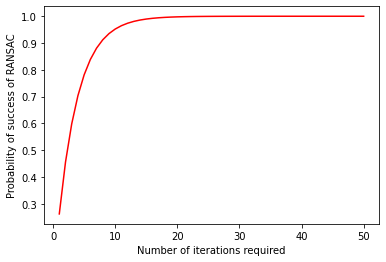

In [19]:
iters = np.linspace(1,50,50)
p = 1-np.power((1-np.power(w,n)),iters)
plt.plot(iters,p,c="r")
plt.xlabel("Number of iterations required")
plt.ylabel("Probability of success of RANSAC")
plt.show()

<h1>Observation for Question-1.1</h1>
<p>For a particualr scale value of a block,the reconstruction error is least for case(b) i.e,Performing reconstruction on the normalized data points (without denormalizing
the projection matrix obtained).The reason could be the same as why normalised things perfom better than original as  in many other general cases.</p>
<hr>
<p>In this question,the other two cases (a) and (c) are almost giving same kind of error</p>
<hr>
<p>The results are almost same when the scale is varied in this question, but i think (b) and (c) should perform better compared to (a) in general because there will  be no effect on them due to normalisation</p>

<h3>Reading all the images required for zhang's method</h3>

In [20]:
images=[]
for i in range(5456,5471):
    image_name='./calibration-data/IMG_'+str(i)+'.JPG'
#     print(image_name)
    current_image=cv2.imread(image_name,cv2.COLOR_BGR2RGB)
    images.append(current_image)
images=np.array(images)
print(images.shape)

(15, 3648, 5472, 3)


<h4>computing world co-ordinates from meshgrid and image co-ordinates from <b>findChessboardCorners</b> in cv2 module</h4>

In [22]:
x,y=np.meshgrid(range(6),range(8))
size=x.shape[0]*x.shape[1]
world_co = []
#Just trimming to 32 bytes from 64 bytes
world_co=29*np.concatenate((x.reshape(size,1),y.reshape(size,1),np.zeros((size,1))),axis=1).astype(np.float32)
# print(type(world_co[0][0]))
# print(world_co)
world_cos=[]
image_cos=[]
for i in range(15):
#     print("iter-"+str(i))
    image =images[i]
    ret, co = cv2.findChessboardCorners(image, (6,8))
#     print(co)
    if ret==True:
        world_cos.append(world_co)
        image_cos.append(co)
world_cos=np.array(world_cos)
image_cos=np.array(image_cos)

<h3>used cv2.calibrateCamera for calibration</h3>
<h4>e&#8594;error,K&#8594;Camera matrix<hr>
rotate_vecs&#8594;gives angle of rotation about x,y,z axis<hr>
translation_vecs&#8594;translation vectors for each image</h4>

In [23]:
print(world_cos.shape,image_cos.shape)
e,K,distort_param,rotate_vecs,translation_vecs = cv2.calibrateCamera(world_cos,image_cos,(images[0].shape[1],images[0].shape[0]),None,None)

(15, 48, 3) (15, 48, 1, 2)


<h4>Printing above mentioned parameters for a sample image</h4>

In [24]:
#Showing Parameters for sample 1st image
print("error="+str(e))
print("Intrinsic Matrix")
print(K)
print("Rotation vector for 1st image")
print(rotate_vecs[0])
print("Translation vector for 1st image")
print(translation_vecs[0])

error=2.4810849837749074
Intrinsic Matrix
[[1.36634768e+04 0.00000000e+00 3.33653479e+03]
 [0.00000000e+00 1.36813825e+04 1.49660002e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Rotation vector for 1st image
[[-0.05108576]
 [-0.03039042]
 [ 1.56728564]]
Translation vector for 1st image
[[ 53.53824571]
 [-60.04502237]
 [905.9630519 ]]


<h3>Constructing P by calculating K,R,t from results of cv2.calibrateCamera  </h3>

In [25]:
def construct_projection_matrix(K,R,t):
    gamma=R[0][0]
    beta=R[1][0]
    alpha=R[2][0]
    c_a=math.cos(alpha)
    s_a=math.sin(alpha)
    c_b=math.cos(beta)
    s_b=math.sin(beta)
    c_g=math.cos(gamma)
    s_g=math.sin(gamma)
    r=np.zeros((3,3))
    r[0][0]=c_a*c_b
    r[0][1]=c_a*s_b*s_g-s_a*c_g
    r[0][2]=c_a*s_b*c_g+s_a*s_g
    r[1][0]=s_a*c_b
    r[1][1]=s_a*s_b*s_g+c_a*c_g
    r[1][2]=s_a*s_b*c_g-c_a*s_g
    r[2][0]=-s_b
    r[2][1]=c_b*s_g
    r[2][2]=c_b*c_g
    r = r.astype('float32')
    P = K@np.concatenate((r,t),axis=1)
    return P

In [26]:
print(construct_projection_matrix(K,rotate_vecs[0],translation_vecs[0]))

[[ 1.49328985e+02 -1.38157897e+04  2.63148649e+03  3.75429582e+06]
 [ 1.37204564e+04 -7.19021062e+00  1.08123601e+03  5.34365406e+05]
 [ 3.03857420e-02 -5.10399640e-02  9.98234272e-01  9.05963052e+02]]


<h3>Method-1&#8594;used inbuilt cv2 function without calculating P</h3>

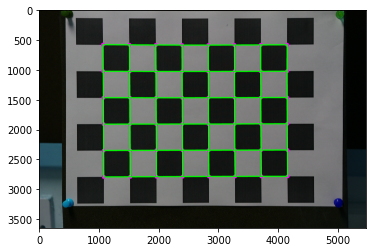

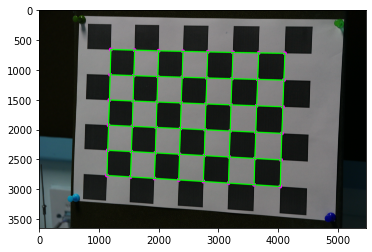

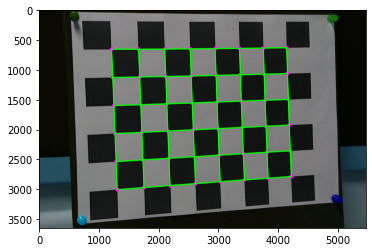

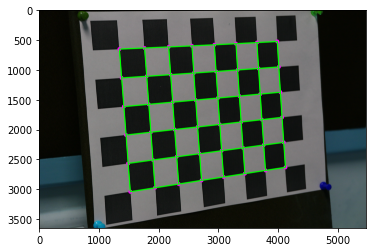

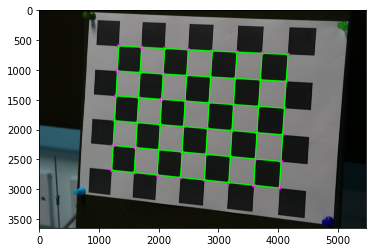

...

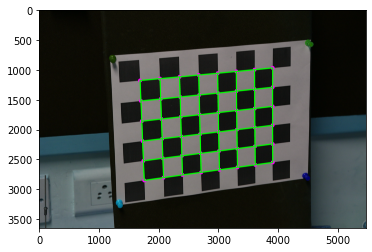

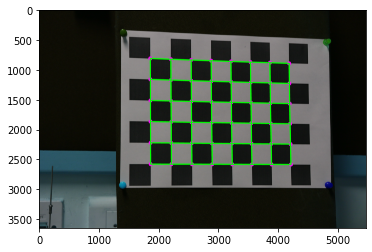

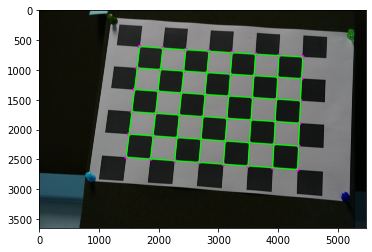

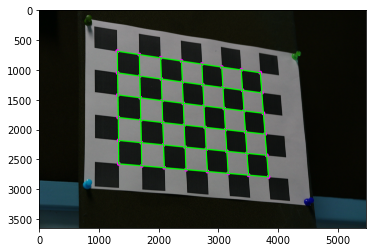

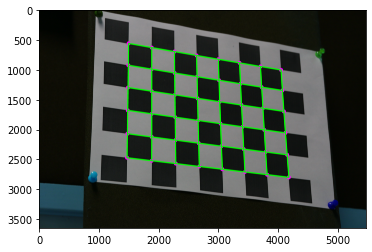

In [27]:
for i in range(15):
    proj_image_co,_ = cv2.projectPoints(world_cos[i],rotate_vecs[i],translation_vecs[i],K,distort_param)
#     print(world_cos[i])
    rows = proj_image_co.shape[0]
    image_name='./calibration-data/IMG_'+str(i+5456)+'.JPG'
    curr_image = cv2.imread(image_name,cv2.COLOR_BGR2RGB)
    proj_image_co=proj_image_co.reshape(proj_image_co.shape[0],proj_image_co.shape[2])
    num_points=proj_image_co.shape[0]
    for j in range(0,size):
        cv2.circle(curr_image,(proj_image_co[j][0],proj_image_co[j][1]),8,(255,0,255),50)
    for j in range(8):
        for k in range(5):
            cv2.line(curr_image,(proj_image_co[j*6+k][0],proj_image_co[j*6+k][1]),(proj_image_co[j*6+k+1][0],proj_image_co[j*6+k+1][1]),(0,255,0),20)
    for j in range(6):
        for k in range(7):
            cv2.line(curr_image,(proj_image_co[j+k*6][0],proj_image_co[j+k*6][1]),(proj_image_co[j+(k+1)*6][0],proj_image_co[j+(k+1)*6][1]),(0,255,0),20)
#     plt.scatter(proj_image_co[:6,0],proj_image_co[:6,1])
    plt.imshow(curr_image)
    plt.show()

<h3>Method-2&#8594;used own construct_projection_matrix function for  calculating P</h3>

(48, 2)


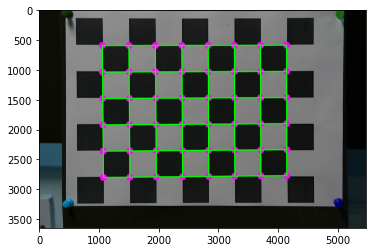

(48, 2)


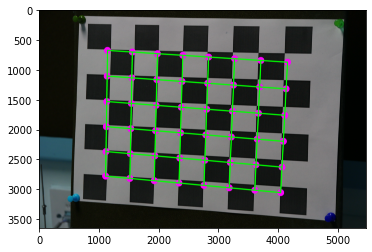

(48, 2)


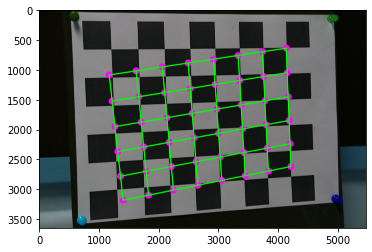

(48, 2)


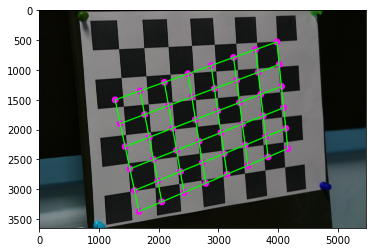

(48, 2)


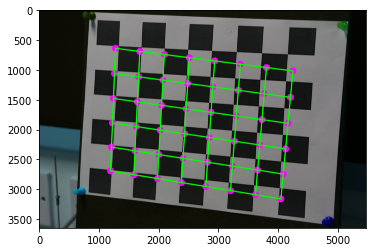

(48, 2)


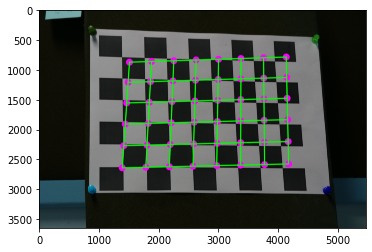

(48, 2)


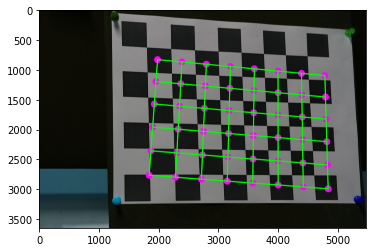

(48, 2)


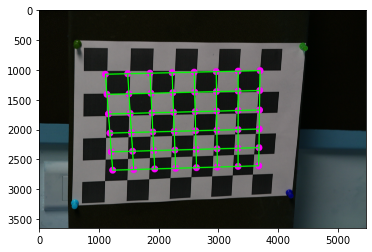

(48, 2)


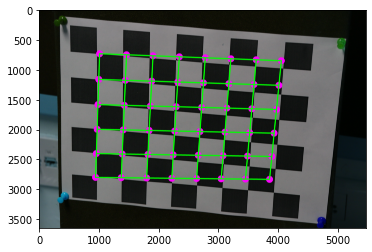

(48, 2)


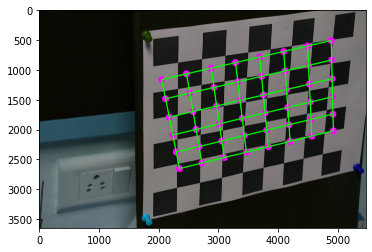

(48, 2)


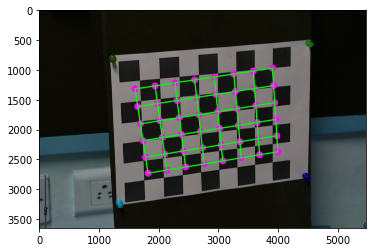

(48, 2)


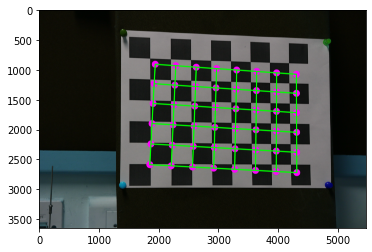

(48, 2)


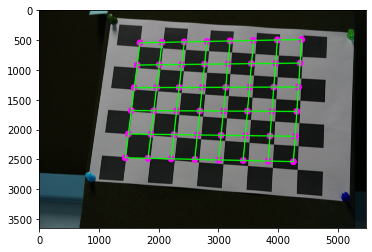

(48, 2)


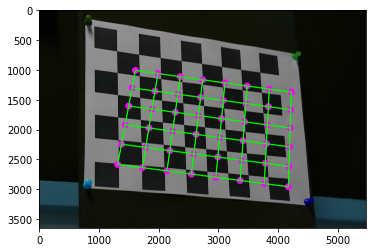

(48, 2)


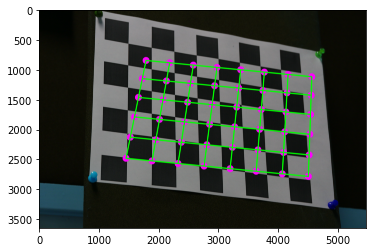

In [28]:
def project_points(p,world_co):
    num_points=world_co.shape[0]
    hom_world_co=np.concatenate((world_co,np.ones((num_points,1))),axis=1)
    proj_img_co=p@(hom_world_co.T)
    proj_img_co= (proj_img_co/ proj_img_co[2,:])[:2]
    return proj_img_co.T
for i in range(15):
    P_curr=construct_projection_matrix(K,rotate_vecs[i],translation_vecs[i])
    proj_image_co=project_points(P_curr,world_cos[i]).astype(np.int32)
    print(proj_image_co.shape)
    rows = proj_image_co.shape[0]
    image_name='./calibration-data/IMG_'+str(i+5456)+'.JPG'
    curr_image = cv2.imread(image_name,cv2.COLOR_BGR2RGB)
    num_points=proj_image_co.shape[0]
    for j in range(0,size):
        cv2.circle(curr_image,(proj_image_co[j][0],proj_image_co[j][1]),8,(255,0,255),100)
    for j in range(8):
        for k in range(5):
            cv2.line(curr_image,(proj_image_co[j*6+k][0],proj_image_co[j*6+k][1]),(proj_image_co[j*6+k+1][0],proj_image_co[j*6+k+1][1]),(0,255,0),20)
    for j in range(6):
        for k in range(7):
            cv2.line(curr_image,(proj_image_co[j+k*6][0],proj_image_co[j+k*6][1]),(proj_image_co[j+(k+1)*6][0],proj_image_co[j+(k+1)*6][1]),(0,255,0),20)
    plt.imshow(curr_image)
    plt.show()

<h1>Observations for Question-2</h1>
<p>The overlay coincides very good when the inbuilt cv2 function is used for projection after the matrices are obtained from calibration but if projection matrix is manually computed,the overlay does not match exactly.
<hr>
    The reason I think this is happening because inbuilt function is also taking into account the distortion parameters obtained where as the function written by me doesn't</p> 

<h3>Showing the own image used for camera calibration</h3>
<hr>
<h3>Description</h3>
<hr>
<ul>
    <li>Used one of the corners as origin and three perpendicular directions as x,y,z axis</li>
    <li>x-dim-range&#8594;(0,21.5cm),y-dim-range&#8594;(0,27.5cm),z-dim-range&#8594;(0,3.5cm)</li>
</ul>

(1280, 960, 3)



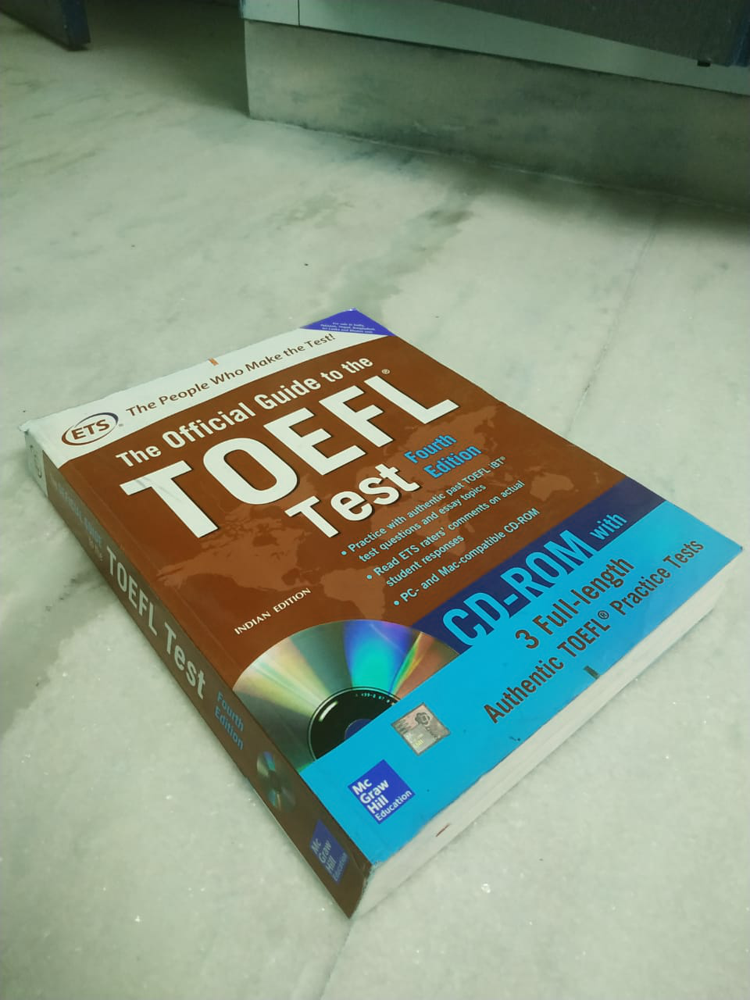

In [29]:
#Own image used for calibration
input_image=cv2.imread("./calibration-data/own_image.jpeg",cv2.COLOR_BGR2RGB)
print(input_image.shape)
import plotly.express as px
fig = px.imshow(input_image)
fig.show()

<h3>Corresponding world and image co-ordinates</h3>

In [30]:
world_co=[[0,0,0],[0,0,3.5],
         [10.75,0,0],[10.75,0,3.5],
         [0,27.5,0],[0,27.5,3.5],
         [21.5,0,0],[10.75,27.5,0],
         [21.5,27.5,0]]
world_co=np.array(world_co)

In [31]:
image_co=[[476,1110],[449,1175],
         [767,867],[786,891],
         [32,548],[29,596],
         [951,702],[270,459],
         [455,394]]
image_co=np.array(image_co)

<h3>Displaying points used for calibration</h3>

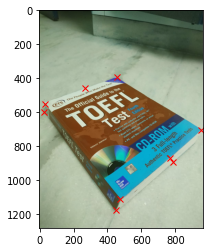

In [32]:
plt.imshow(input_image)
for point in image_co:
    plt.plot(point[0],point[1],'rx')
plt.show()

<h3>Parameters estimated with DLT</h3>

In [33]:
P=DLT(world_co,image_co)
print(P)
K,R,t=decompose(P)
print(K)
print(R)
print(t)
print(MSE_error(P,world_co,image_co))

[[-3.66003804e-02  1.25943352e-02  1.60469865e-03 -3.90047790e-01]
 [ 3.13618855e-03  4.93501933e-03 -9.42947982e-03 -9.19912034e-01]
 [-1.86742544e-05 -2.13918313e-05  4.74282067e-06 -8.27957936e-04]]
[[ 1.23551859e+03  1.59277432e+02  5.08763452e+02]
 [ 0.00000000e+00  2.91598205e+02 -2.51989874e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[[-0.73776662  0.66703932  0.10372542]
 [-0.18696168 -0.05425945 -0.9808676 ]
 [-0.64864917 -0.74304405  0.16474161]]
[ -30.35554722  -40.80832229 -129.01057489]
10.878766194557752


<h3>Plotting actual and projected points</h3>

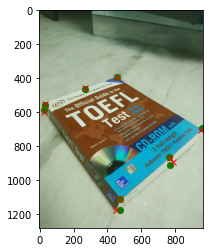

In [34]:
plt.imshow(input_image)
proj_image_co=project_points(P,world_co)
for i in range(image_co.shape[0]):
    proj_point=proj_image_co[i]
    point=image_co[i]
    plt.plot(proj_point[0],proj_point[1],'go')
    plt.plot(point[0],point[1],'rx')
plt.show()

<h3>Parameters estimated with RANSAC</h3>

In [35]:
import warnings
warnings.filterwarnings('ignore')
P=RANSAC(world_co,image_co)
print(P)
K,R,t=decompose(P)
print(K)
print(R)
print(t)
print(MSE_error(P,world_co,image_co))

[[-3.67823357e-02  1.26599686e-02  1.09813536e-03 -3.93669286e-01]
 [ 2.11757183e-03  5.37302229e-03 -2.85793094e-02 -9.17964747e-01]
 [-2.00145658e-05 -2.15478525e-05 -1.48282901e-05 -8.14875208e-04]]
[[-1.09522471e+03 -1.63333304e+02  4.12164298e+02]
 [ 0.00000000e+00  8.50727141e+02  2.44865436e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[[-0.75364351  0.65385088  0.06708563]
 [-0.250485   -0.38007005  0.89039543]
 [ 0.60768308  0.6542368   0.45021716]]
[-12.70184363  -2.89347632 -33.60502913]
10.385311090167484


<h3>Plotting actual and projected points</h3>

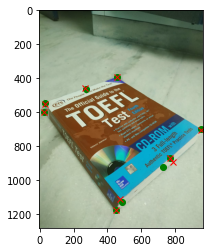

In [36]:
plt.imshow(input_image)
proj_image_co=project_points(P,world_co)
for i in range(image_co.shape[0]):
    proj_point=proj_image_co[i]
    point=image_co[i]
    plt.plot(proj_point[0],proj_point[1],'go')
    plt.plot(point[0],point[1],'rx')
plt.show()

<h1>Observations for Question-3</h1>
<h3>The reconstruction is slightly less for RANSAC version in my case,can't say wether it is true in general</h3>
<hr>
<h5>Note&#8594;As I used only 10 points for calibration,in some iterations, all the 6 points selected at random may lie on a single plane in RANSAC,we can't calibrate in that iteration</h5>